In [137]:
!pip install pmdarima
!pip install prophet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [138]:
import pandas as pd
import zipfile
import matplotlib.pyplot as plt
from datetime import datetime
import numpy as np
import statsmodels.tsa.api as smt
import matplotlib.dates as mdates
import statsmodels.api as sm
from pandas.plotting import lag_plot
from pmdarima.arima import ndiffs
import pmdarima as pm
from pmdarima.model_selection import train_test_split
from copy import deepcopy

In [139]:
with zipfile.ZipFile('/content/data.zip', 'r') as zip_ref:
    zip_ref.extractall()

In [140]:
def data_plot(data, cols, start='2011-01-01', end='2021-12-30'):
  # plt.figure(figsize=(12, 7))
  fig, ax = plt.subplots(figsize=(20, 10))
  start = pd.to_datetime(start)
  end = pd.to_datetime(end)
  for col in cols:
    ax.plot(data[start: end][col], label=col, linewidth=2)
    # plt.plot(data[start: end][col], linewidth=5.0)
  plt.xlabel('date')  
  ax.legend()
  plt.show()

In [141]:
def tsplot(y, lags=None, figsize=(12, 7), style='bmh', start='2011-01-01', end='2021-12-30'):
    if not isinstance(y, pd.Series):
        y = pd.Series(y[start: end])
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        layout = (2, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))

        y.plot(ax=ts_ax)
        ts_ax.set_title('Time Series Analysis Plots')
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax, alpha=0.5)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.5)

        print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(y)[1])      
        plt.tight_layout()


In [142]:
def diki (otg):
  test = sm.tsa.stattools.adfuller(otg)
  print ('adf: ', test[0])
  print ('p-value: ', test[1])
  print ('Critical values: ', test[4])
  if test[0]> test[4]['5%']: 
      print ('есть единичные корни, ряд не стационарен')
  else:
      print ('единичных корней нет, ряд стационарен')

In [143]:
def tsplot(y, lags=None, figsize=(20, 12), style='bmh', start='2011-01-01', end='2021-12-30'):
    if not isinstance(y, pd.Series):
        y = pd.Series(y[start: end])
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        layout = (2, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))

        y.plot(ax=ts_ax)
        ts_ax.set_title('Time Series Analysis Plots')
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax, alpha=0.5)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.5)

        print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(y)[1])      
        plt.tight_layout()


In [144]:
def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [145]:
df = pd.read_csv('data.csv', parse_dates=['dt'])
df.set_index('dt', inplace=True)
df.head()

,MW
dt,
2011-01-01 00:00:00,3416.0
2011-01-01 00:15:00,4755.0
2011-01-01 00:30:00,4939.0
2011-01-01 00:45:00,4939.0
2011-01-01 01:00:00,4998.0


In [146]:
prodf = pd.read_csv('data.csv', parse_dates=['dt'])
prodf = prodf.resample('D', on='dt').sum()
prodf.reset_index(inplace=True)
prodf.columns= ['ds', 'y']
prodf.head()

,ds,y
0,2011-01-01,518229.0
1,2011-01-02,83077.0
2,2011-01-03,73095.0
3,2011-01-04,376606.0
4,2011-01-05,216599.0


In [147]:
prodf1 = pd.read_csv('data.csv', parse_dates=['dt'])
prodf1 = prodf1.resample('MS', on='dt').sum()
prodf1.reset_index(inplace=True)
prodf1.columns= ['ds', 'y']
prodf1.head()

,ds,y
0,2011-01-01,4753535.0
1,2011-02-01,4502270.0
2,2011-03-01,4948915.0
3,2011-04-01,4795377.0
4,2011-05-01,5590865.0


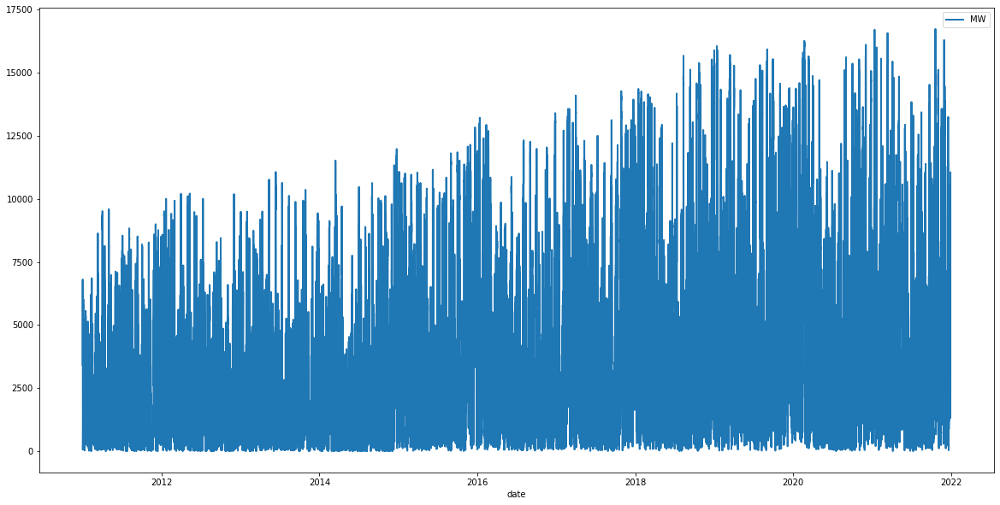

In [148]:
data_plot(df, cols=['MW'],)

на первый взгляд ряд стационарный, так как не наблюдается тренда. Среднее по всему датасету не увеличивается

In [149]:
# tsplot(df.MW, lags=30) # не запускать, съедает всю память

In [150]:
df.describe()

,MW
count,385566.000000
mean,3183.560481
std,3045.941591
min,0.000000
25%,905.000000
50%,2164.000000
75%,4529.877500
max,16727.500000


перейдем от 15 минутных данных к дневным

In [151]:
df.reset_index(inplace=True)

In [156]:
data = df.resample('D', on='dt').sum()
data.tail()

,MW
dt,
2021-12-26,294921.35
2021-12-27,603998.08
2021-12-28,659450.45
2021-12-29,241640.15
2021-12-30,220220.08


Проверим наш ряд на стационрность по критерию Дикки-Фуллера

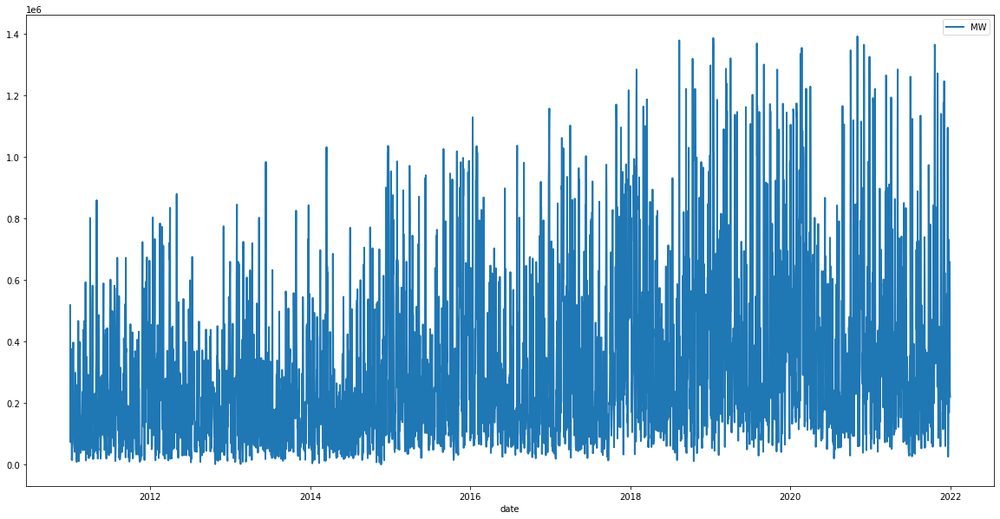

In [157]:
data_plot(data, ['MW'])

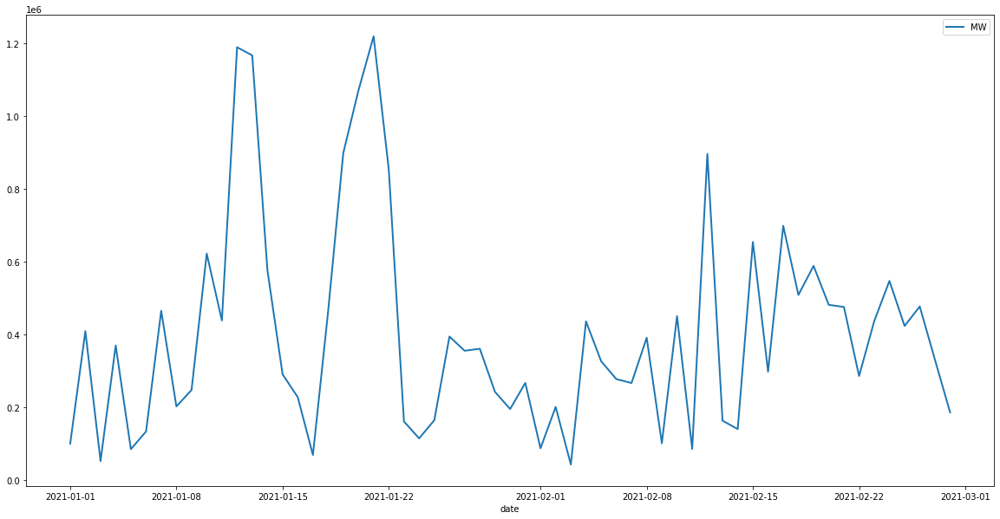

In [159]:
data_plot(data, ['MW'], start='2021-01-01', end='2021-02-28')

по графикам выше, можно подумать, что ряд не стационарен, так как у него есть еле уловимйый тренд.

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Критерий Дики-Фуллера: p=0.000006


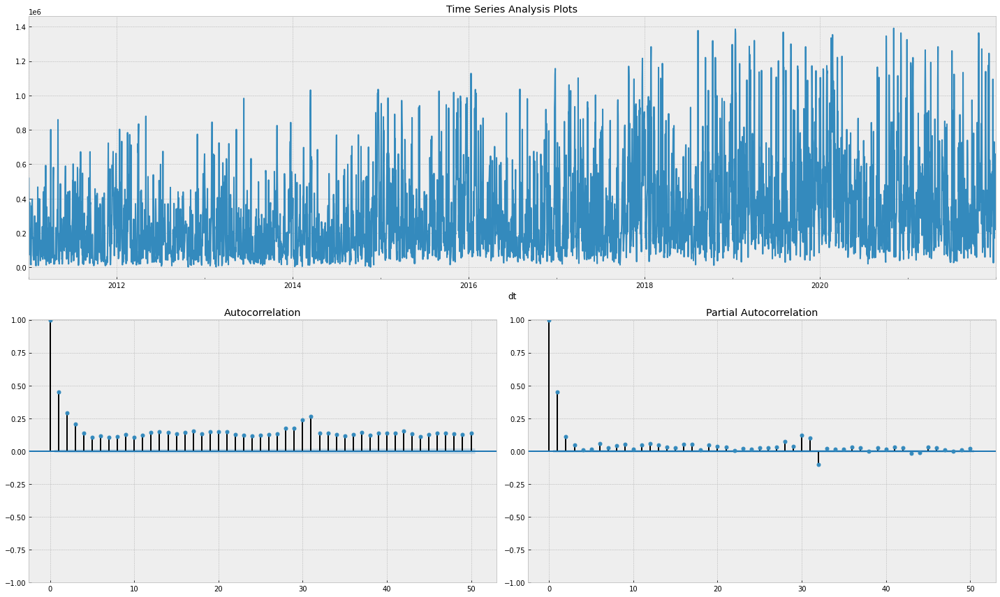

In [160]:
tsplot(data.MW, lags=50)

Но тест Дики-Фуллера говорит, что ряд стационарен и сезонность в ряду отсутствует

In [161]:
diki(data.MW)

adf:  -5.266921224243938
p-value:  6.4090573667228544e-06
Critical values:  {'1%': -3.431992036963141, '5%': -2.862265562109333, '10%': -2.567156224565458}
единичных корней нет, ряд стационарен


Со сдвигом на 1

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Критерий Дики-Фуллера: p=0.000000


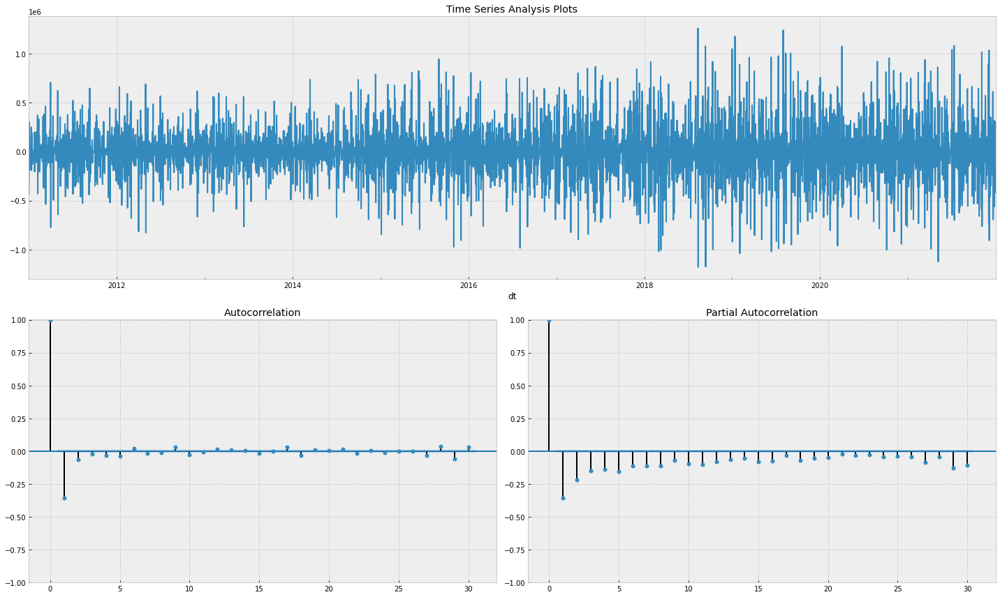

In [162]:
otgdiff = data.MW.diff(periods=1).dropna()
tsplot(otgdiff, lags=30)

In [163]:
diki(otgdiff)

adf:  -20.12234639272122
p-value:  0.0
Critical values:  {'1%': -3.431992449387031, '5%': -2.862265744295594, '10%': -2.5671563215537856}
единичных корней нет, ряд стационарен


Такая задача, является задачей регрессии. Наиболее подходящий здесь метод, это модель Prophet. Применим к стационарному ряду модель prophet, но сделаем несколько различных подходом. Без группировки, к неделе и к месяцу

In [233]:
import datetime
import lightgbm as lgb
import xgboost as xgb
import plotly.express as px
import seaborn as sns

from typing import Optional, List, Dict
from prophet import Prophet
from xgboost import plot_importance, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

plt.style.use('fivethirtyeight')

In [234]:
data = pd.read_csv('data.csv', parse_dates=['dt']).reset_index()
# data.set_index('dt', inplace=True)
data.head()

,index,dt,MW
0,0,2011-01-01 00:00:00,3416.0
1,1,2011-01-01 00:15:00,4755.0
2,2,2011-01-01 00:30:00,4939.0
3,3,2011-01-01 00:45:00,4939.0
4,4,2011-01-01 01:00:00,4998.0


In [235]:
seasons = ['Winter','Winter','Spring','Spring','Spring','Summer','Summer','Summer','Autumn','Autumn','Autumn','Winter']
season_num = [4,4,1,1,1,2,2,2,3,3,3,4]
month_to_season_num = dict(zip(range(1,13), season_num))

In [236]:
def return_date_features(df, datetime_col):
    """
    Create date related features for the datetime column that is passed 
    returns Input dataframe with additional time related feature columns
    """
    df['date_hour'] = df[datetime_col].dt.floor('H')
    df['date'] = df[datetime_col].dt.floor('D')
    df['hour_of_day'] = df[datetime_col].dt.hour
    df['day_of_week'] = df[datetime_col].dt.dayofweek
    df['month_of_year'] = df[datetime_col].dt.month
    df['day_of_year'] = df[datetime_col].dt.dayofyear
    df['week_of_year'] = df[datetime_col].dt.isocalendar().week
    
    df['Season'] = df[datetime_col].dt.month.map(month_to_season_num)
    
    return df

In [237]:
data = return_date_features(data, 'dt')
data.head()

,index,dt,MW,date_hour,date,hour_of_day,day_of_week,month_of_year,day_of_year,week_of_year,Season
0,0,2011-01-01 00:00:00,3416.0,2011-01-01 00:00:00,2011-01-01,0,5,1,1,52,4
1,1,2011-01-01 00:15:00,4755.0,2011-01-01 00:00:00,2011-01-01,0,5,1,1,52,4
2,2,2011-01-01 00:30:00,4939.0,2011-01-01 00:00:00,2011-01-01,0,5,1,1,52,4
3,3,2011-01-01 00:45:00,4939.0,2011-01-01 00:00:00,2011-01-01,0,5,1,1,52,4
4,4,2011-01-01 01:00:00,4998.0,2011-01-01 01:00:00,2011-01-01,1,5,1,1,52,4


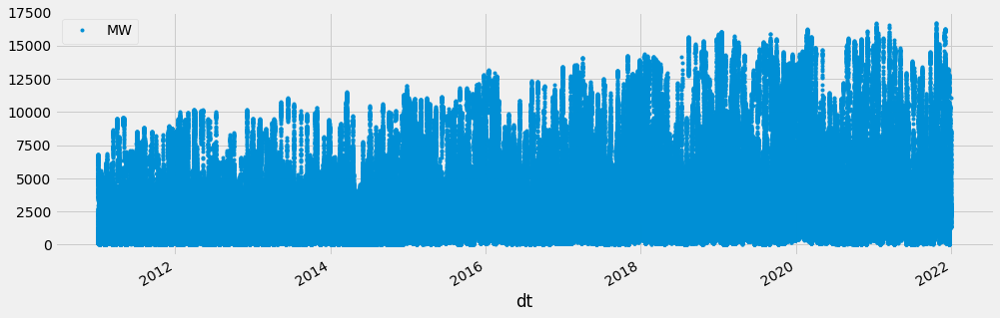

In [238]:
fig = data.plot(x="dt", y="MW", style='.', figsize=(15,5))

In [239]:
#plotting additional aggregates for the features that were created

def lineplot_agg_grouped(df, group_col, target_col, y_label, agg_type = 'mean', x_ticks = 0):
    """
    plots the aggregate value of a column in a dataframe grouped by another column
    """
    agg_df = df.groupby([group_col]).agg({target_col:agg_type}).reset_index()
    plt.figure(figsize=(6,4))
    ax = sns.lineplot(data=agg_df, x=agg_df[group_col], y=target_col, marker='o')
    ax.set(ylabel=y_label)
    plt.xticks(rotation=x_ticks)
    
    return

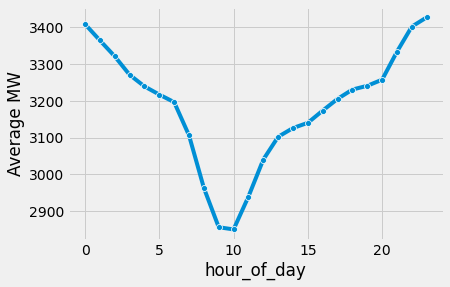

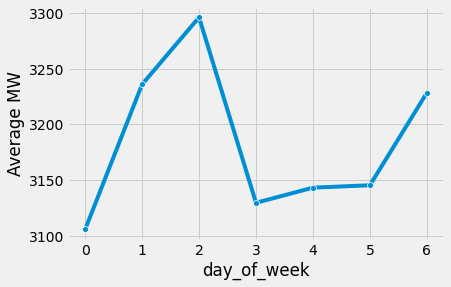

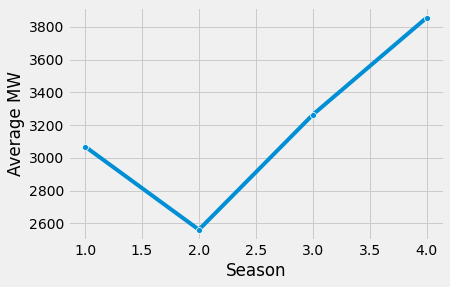

In [240]:
# plot average observations grouped by different features

data_features = ['hour_of_day','day_of_week','Season']

for ts_feature in data_features:
    lineplot_agg_grouped(
        df = data,
        group_col = ts_feature,
        target_col = 'MW',
        y_label = 'Average MW',
        agg_type = 'mean',
        x_ticks=0)

Летом меньше, чм в остальные сезоны

In [241]:
split_date = '2019-10-22'
data['type'] = 'train'
data.loc[data['dt']>= split_date, 'type'] = 'test'
train = data.loc[data['type'] == 'train'].reset_index(drop=True)
test = data.loc[data['type'] == 'test'].reset_index(drop=True)

In [242]:
train.shape, test.shape

((308730, 12), (76836, 12))

In [243]:
#plotting time series grouped by train and test datasets
fig = px.scatter(data, x="dt", y="MW", hover_data=['day_of_week'], color='type')
fig.update_traces(mode='markers+lines', marker_size=3)
fig.show()

In [244]:
def eval_accuracy(y_true, y_pred):
    """
    y_true - actual values as pandas series
    y_pred - predicted values as pandas series
    return: dictionary with MAE, RMSE and MAPE metrics
    """
    #mean absolute error (MAE)
    mae = mean_absolute_error(y_true, y_pred)
    
    #root mean squared error (RMSE)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    
    #mean absolute percentage error (MAPE)
    mape = np.mean(np.abs((y_true-y_pred) / y_true)) * 100
    
    return {'MAE': round(mae, 3),
           'RMSE': round(rmse, 3),
           'MAPE': round(mape, 3)}

In [245]:
model_prophet = Prophet(changepoint_prior_scale= 0.5,seasonality_prior_scale=0.01)
model_prophet.fit(train.rename(columns={'dt':'ds', 'MW':'y'}))
test_prophet = model_prophet.predict(df = test.rename(columns={'dt':'ds', 'MW':'y'}))

DEBUG:cmdstanpy:input tempfile: /tmp/tmptihujix3/qyicx0if.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptihujix3/5jxpm_nw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47492', 'data', 'file=/tmp/tmptihujix3/qyicx0if.json', 'init=/tmp/tmptihujix3/5jxpm_nw.json', 'output', 'file=/tmp/tmptihujix3/prophet_modelv7c3iu97/prophet_model-20221025200634.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:06:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:13:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


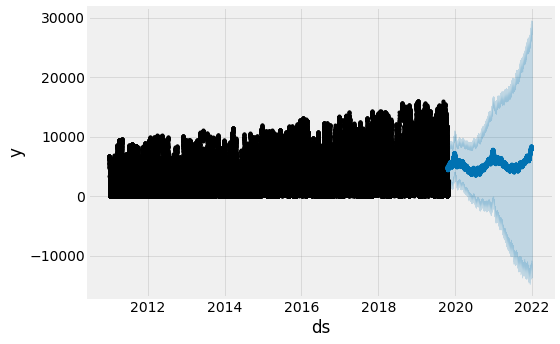

In [246]:
# plot historical values and forecast values

fig = model_prophet.plot(test_prophet, figsize=(8,5))

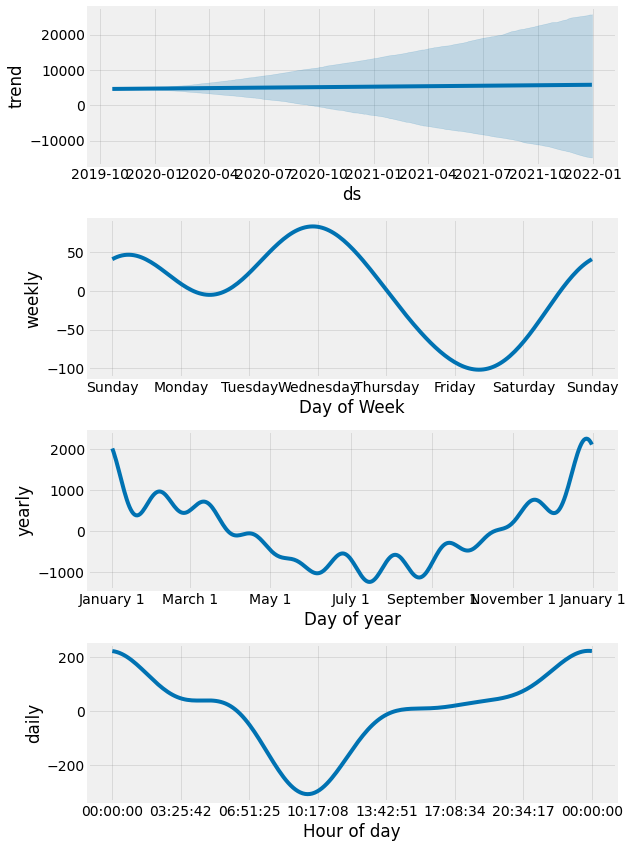

In [247]:
fig = model_prophet.plot_components(test_prophet)

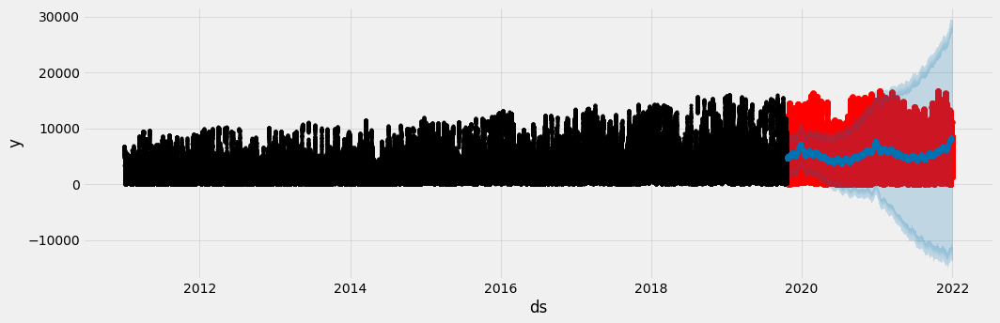

In [248]:
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
ax.scatter(test["dt"], test["MW"], color='r')
fig = model_prophet.plot(test_prophet, ax=ax)

In [249]:
eval_accuracy(test["MW"],test_prophet['yhat'])

{'MAE': 3142.825, 'RMSE': 3702.815, 'MAPE': 313.045}

In [250]:
# plot actual vs forecast in an interactive plot

test = pd.merge(left=test, right=test_prophet.rename(columns={'ds':"dt",'yhat':'prediction'}), 
               on = "dt",
               how="left")

In [251]:
# plot

fig = px.scatter(test, x="dt", y=["MW", "prediction"],
                hover_data=["day_of_week"])
fig.update_traces(mode='markers+lines', marker_size=3)
fig.show()

несмотря на ошибку, в целом модель работает верно

In [283]:
data = pd.read_csv('data.csv', parse_dates=['dt']).reset_index()
# data.set_index('dt', inplace=True)
data = data.resample('D', on='dt').sum()
data.reset_index(inplace=True)
# prodf.columns= ['ds', 'y']
data.head()

,dt,index,MW
0,2011-01-01,4560,518229.0
1,2011-01-02,13776,83077.0
2,2011-01-03,22992,73095.0
3,2011-01-04,32208,376606.0
4,2011-01-05,41424,216599.0


In [284]:
seasons = ['Winter','Winter','Spring','Spring','Spring','Summer','Summer','Summer','Autumn','Autumn','Autumn','Winter']
season_num = [4,4,1,1,1,2,2,2,3,3,3,4]
month_to_season_num = dict(zip(range(1,13), season_num))

In [285]:
def return_date_features(df, datetime_col):
    """
    Create date related features for the datetime column that is passed 
    returns Input dataframe with additional time related feature columns
    """
    
    df['date'] = df[datetime_col].dt.floor('D')
    df['day_of_week'] = df[datetime_col].dt.dayofweek
    df['month_of_year'] = df[datetime_col].dt.month
    df['day_of_year'] = df[datetime_col].dt.dayofyear
    df['week_of_year'] = df[datetime_col].dt.isocalendar().week
    
    df['Season'] = df[datetime_col].dt.month.map(month_to_season_num)
    
    return df

In [286]:
data = return_date_features(data, 'dt')
data.head()

,dt,index,MW,date,day_of_week,month_of_year,day_of_year,week_of_year,Season
0,2011-01-01,4560,518229.0,2011-01-01,5,1,1,52,4
1,2011-01-02,13776,83077.0,2011-01-02,6,1,2,52,4
2,2011-01-03,22992,73095.0,2011-01-03,0,1,3,1,4
3,2011-01-04,32208,376606.0,2011-01-04,1,1,4,1,4
4,2011-01-05,41424,216599.0,2011-01-05,2,1,5,1,4


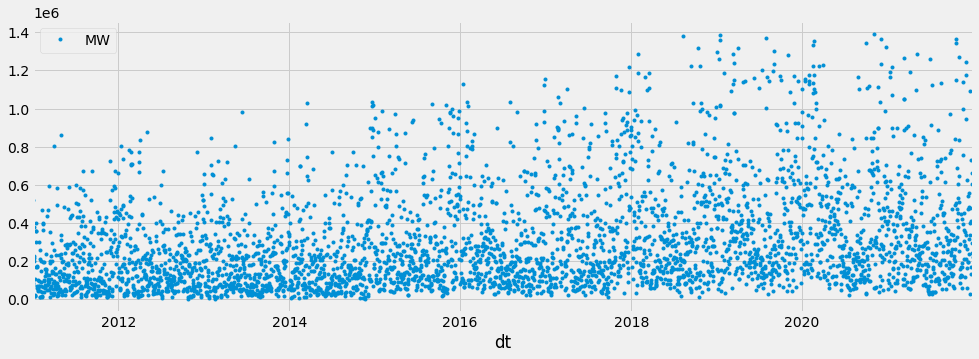

In [287]:
fig = data.plot(x="dt", y="MW", style='.', figsize=(15,5))

In [ ]:
#plotting additional aggregates for the features that were created

def lineplot_agg_grouped(df, group_col, target_col, y_label, agg_type = 'mean', x_ticks = 0):
    """
    plots the aggregate value of a column in a dataframe grouped by another column
    """
    agg_df = df.groupby([group_col]).agg({target_col:agg_type}).reset_index()
    plt.figure(figsize=(6,4))
    ax = sns.lineplot(data=agg_df, x=agg_df[group_col], y=target_col, marker='o')
    ax.set(ylabel=y_label)
    plt.xticks(rotation=x_ticks)
    
    return

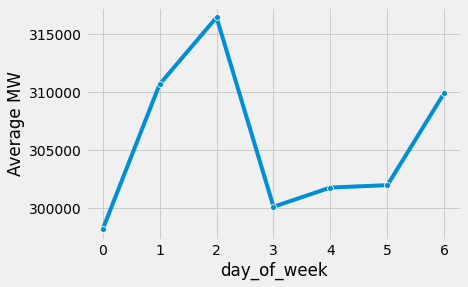

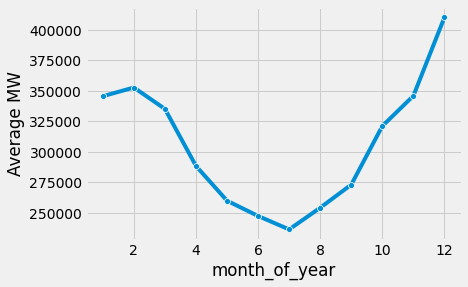

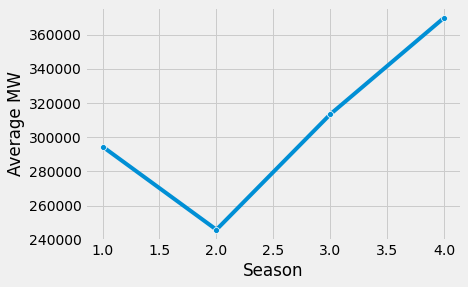

In [288]:
# plot average observations grouped by different features

data_features = ['day_of_week','month_of_year', 'Season']

for ts_feature in data_features:
    lineplot_agg_grouped(
        df = data,
        group_col = ts_feature,
        target_col = 'MW',
        y_label = 'Average MW',
        agg_type = 'mean',
        x_ticks=0)

In [291]:
split_date = '2019-10-22'
data['type'] = 'train'
data.loc[data['dt']>= split_date, 'type'] = 'test'
train = data.loc[data['type'] == 'train'].reset_index(drop=True)
test = data.loc[data['type'] == 'test'].reset_index(drop=True)

In [292]:
train.shape, test.shape

((3216, 10), (801, 10))

In [293]:
#plotting time series grouped by train and test datasets
fig = px.scatter(data, x="dt", y="MW", hover_data=['day_of_week'], color='type')
fig.update_traces(mode='markers+lines', marker_size=3)
fig.show()

In [294]:
model_prophet = Prophet(changepoint_prior_scale= 0.5,seasonality_prior_scale=0.01)
model_prophet.fit(train.rename(columns={'dt':'ds', 'MW':'y'}))
test_prophet = model_prophet.predict(df = test.rename(columns={'dt':'ds', 'MW':'y'}))

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptihujix3/s0vj63p5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptihujix3/mfnxx81w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71564', 'data', 'file=/tmp/tmptihujix3/s0vj63p5.json', 'init=/tmp/tmptihujix3/mfnxx81w.json', 'output', 'file=/tmp/tmptihujix3/prophet_model_c9rg853/prophet_model-20221025204041.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:40:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:40:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


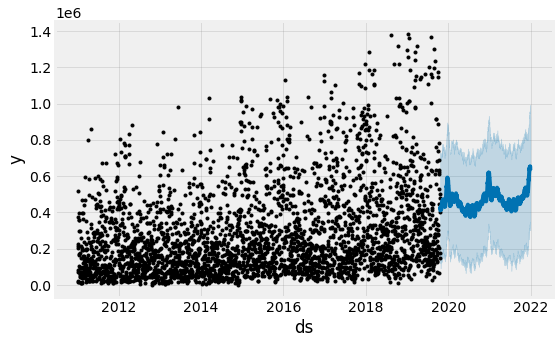

In [295]:
# plot historical values and forecast values

fig = model_prophet.plot(test_prophet, figsize=(8,5))

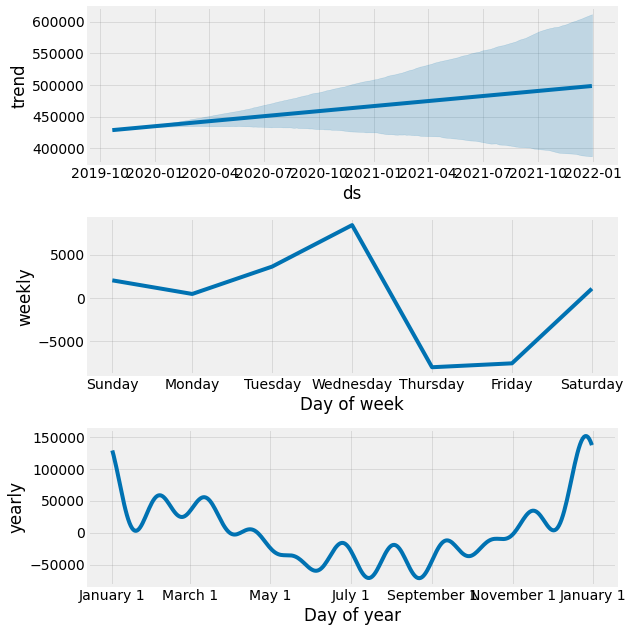

In [296]:
fig = model_prophet.plot_components(test_prophet)

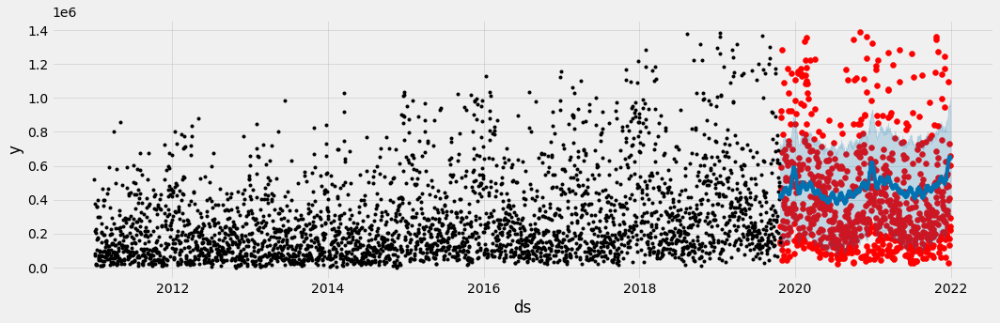

In [297]:
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
ax.scatter(test["dt"], test["MW"], color='r')
fig = model_prophet.plot(test_prophet, ax=ax)

In [298]:
eval_accuracy(test["MW"],test_prophet['yhat'])

{'MAE': 256515.423, 'RMSE': 309956.955, 'MAPE': 145.888}

In [299]:
# plot actual vs forecast in an interactive plot

test = pd.merge(left=test, right=test_prophet.rename(columns={'ds':"dt",'yhat':'prediction'}), 
               on = "dt",
               how="left")

In [300]:
# plot

fig = px.scatter(test, x="dt", y=["MW", "prediction"],
                hover_data=["day_of_week"])
fig.update_traces(mode='markers+lines', marker_size=3)
fig.show()

In [301]:
data = pd.read_csv('data.csv', parse_dates=['dt']).reset_index()
# data.set_index('dt', inplace=True)
data = data.resample('MS', on='dt').sum()
data.reset_index(inplace=True)
# prodf.columns= ['ds', 'y']
data.head()

,dt,index,MW
0,2011-01-01,4426800,4753535.0
1,2011-02-01,11610816,4502270.0
2,2011-03-01,21248314,4948915.0
3,2011-04-01,29017440,4795377.0
4,2011-05-01,38698416,5590865.0


In [302]:
def return_date_features(df, datetime_col):
    """
    Create date related features for the datetime column that is passed 
    returns Input dataframe with additional time related feature columns
    """
    
    # df['date'] = df[datetime_col].dt.floor('D')
    # df['day_of_week'] = df[datetime_col].dt.dayofweek
    df['month_of_year'] = df[datetime_col].dt.month
    # df['day_of_year'] = df[datetime_col].dt.dayofyear
    # df['week_of_year'] = df[datetime_col].dt.isocalendar().week
    
    df['Season'] = df[datetime_col].dt.month.map(month_to_season_num)
    
    return df

In [303]:
data = return_date_features(data, 'dt')
data.head()

,dt,index,MW,month_of_year,Season
0,2011-01-01,4426800,4753535.0,1,4
1,2011-02-01,11610816,4502270.0,2,4
2,2011-03-01,21248314,4948915.0,3,1
3,2011-04-01,29017440,4795377.0,4,1
4,2011-05-01,38698416,5590865.0,5,1


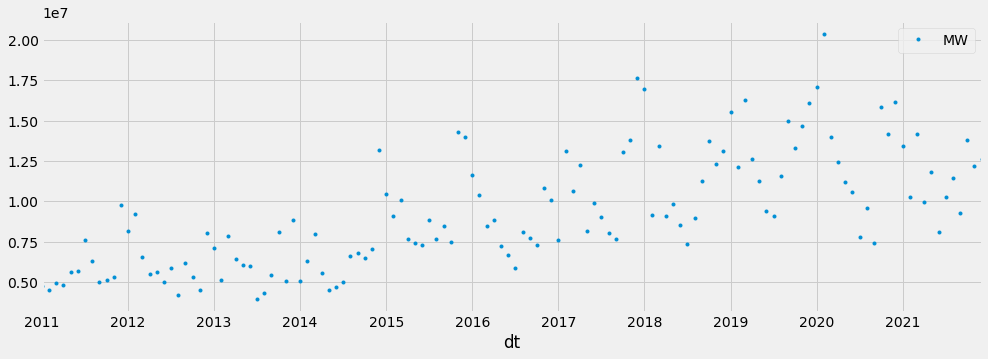

In [304]:
fig = data.plot(x="dt", y="MW", style='.', figsize=(15,5))

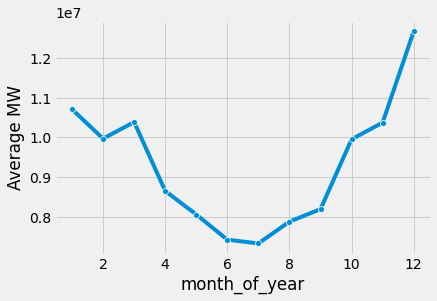

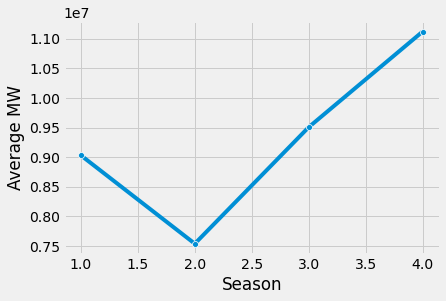

In [306]:
# plot average observations grouped by different features

data_features = ['month_of_year', 'Season']

for ts_feature in data_features:
    lineplot_agg_grouped(
        df = data,
        group_col = ts_feature,
        target_col = 'MW',
        y_label = 'Average MW',
        agg_type = 'mean',
        x_ticks=0)

In [307]:
split_date = '2019-10-01'
data['type'] = 'train'
data.loc[data['dt']>= split_date, 'type'] = 'test'
train = data.loc[data['type'] == 'train'].reset_index(drop=True)
test = data.loc[data['type'] == 'test'].reset_index(drop=True)

In [308]:
train.shape, test.shape

((105, 6), (27, 6))

In [310]:
#plotting time series grouped by train and test datasets
fig = px.scatter(data, x="dt", y="MW", hover_data=['month_of_year'], color='type')
fig.update_traces(mode='markers+lines', marker_size=3)
fig.show()

In [311]:
model_prophet = Prophet(changepoint_prior_scale= 0.5,seasonality_prior_scale=0.01)
model_prophet.fit(train.rename(columns={'dt':'ds', 'MW':'y'}))
test_prophet = model_prophet.predict(df = test.rename(columns={'dt':'ds', 'MW':'y'}))

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptihujix3/3kdqm3t8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptihujix3/hp_g4bti.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64175', 'data', 'file=/tmp/tmptihujix3/3kdqm3t8.json', 'init=/tmp/tmptihujix3/hp_g4bti.json', 'output', 'file=/tmp/tmptihujix3/prophet_modelm_yimh4r/prophet_model-20221025204400.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:44:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:44:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


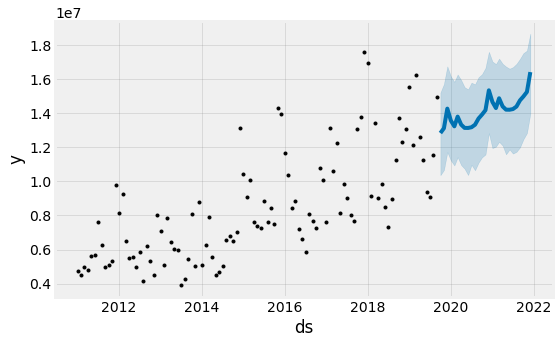

In [312]:
# plot historical values and forecast values

fig = model_prophet.plot(test_prophet, figsize=(8,5))

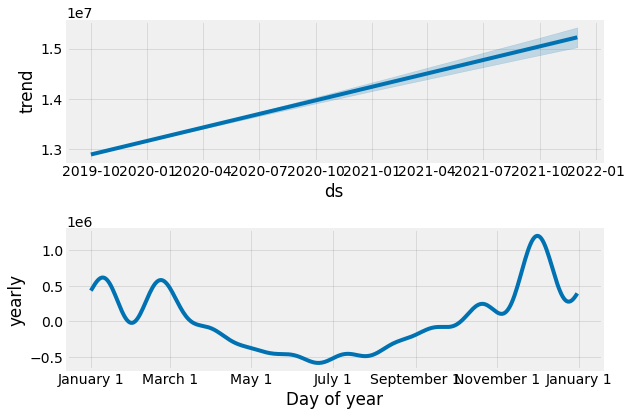

In [313]:
fig = model_prophet.plot_components(test_prophet)

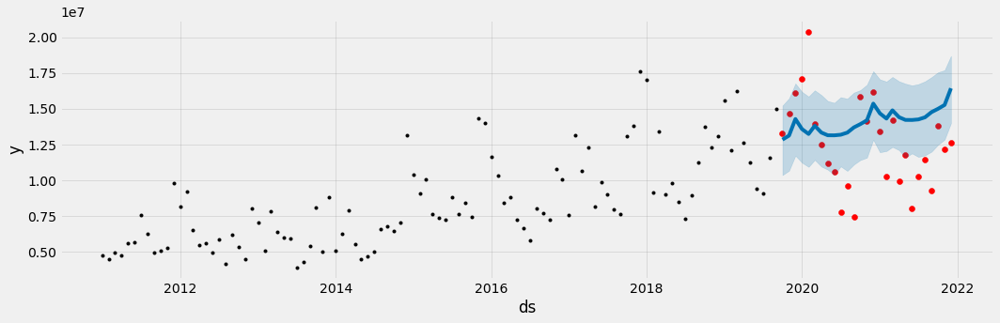

In [314]:
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
ax.scatter(test["dt"], test["MW"], color='r')
fig = model_prophet.plot(test_prophet, ax=ax)

In [315]:
eval_accuracy(test["MW"],test_prophet['yhat'])

{'MAE': 2875629.806, 'RMSE': 3492774.135, 'MAPE': 26.786}

In [316]:
# plot actual vs forecast in an interactive plot

test = pd.merge(left=test, right=test_prophet.rename(columns={'ds':"dt",'yhat':'prediction'}), 
               on = "dt",
               how="left")

In [318]:
# plot

fig = px.scatter(test, x="dt", y=["MW", "prediction"],
                hover_data=["month_of_year"])
fig.update_traces(mode='markers+lines', marker_size=3)
fig.show()